# Fetching Data

In [3]:
import ccxt
import pandas as pd
from datetime import datetime

# Initialize the Indodax exchange
exchange = ccxt.indodax()

# Define the trading pair and timeframe
symbol = 'USDT/IDR'  # Example: USDT to Indonesian Rupiah
timeframe = '1m'     # Supported timeframes: '1m', '5m', '15m', '1h', '1d', etc.
limit = 1000000      # Number of candles to fetch (max depends on the exchange)

# Fetch OHLCV data
ohlcv = exchange.fetch_ohlcv(symbol, timeframe, limit=limit)

# Convert to DataFrame
columns = ['date', 'open', 'high', 'low', 'close', 'volume']
data = [
    [datetime.utcfromtimestamp(c[0] / 1000).strftime('%Y-%m-%d %H:%M:%S'), *c[1:]]
    for c in ohlcv
]
indodax_df = pd.DataFrame(data, columns=columns)

# Ensure 'date' column is in datetime format
indodax_df['date'] = pd.to_datetime(indodax_df['date'])

# Convert from UTC to Bali time (UTC+8)
indodax_df['date'] = indodax_df['date'] + pd.Timedelta(hours=8)

indodax_df = indodax_df.tail(len(indodax_df))

# Print the DataFrame
indodax_df

,date,open,high,low,close,volume
0,2023-01-16 05:44:00,15130.0,15130.0,15130.0,15130.0,10.324082
1,2023-01-16 05:45:00,15128.0,15128.0,15128.0,15128.0,169.778572
2,2023-01-16 05:46:00,15128.0,15128.0,15128.0,15128.0,0.000000
3,2023-01-16 05:47:00,15130.0,15130.0,15130.0,15130.0,1.034435
4,2023-01-16 05:48:00,15128.0,15128.0,15128.0,15128.0,49.566023
...,...,...,...,...,...,...
999995,2024-12-10 16:19:00,15960.0,15960.0,15959.0,15960.0,210.546781
999996,2024-12-10 16:20:00,15960.0,15960.0,15959.0,15959.0,116.692388
999997,2024-12-10 16:21:00,15959.0,15960.0,15959.0,15959.0,457.345170
999998,2024-12-10 16:22:00,15959.0,15960.0,15959.0,15959.0,2619.453947


# Data Exploration

In [2]:
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55168,2024-12-09 07:00:00,15809.0,15850.0,15809.0,15821.0,122403.374977
55169,2024-12-09 08:00:00,15817.0,15899.0,15817.0,15867.0,124707.612850
55170,2024-12-09 09:00:00,15867.0,15888.0,15825.0,15875.0,140598.635472
55171,2024-12-09 10:00:00,15875.0,15900.0,15805.0,15874.0,564793.494516


In [36]:
n = 3

# Take the last n months
latest_n_month = indodax_df.tail(n*720+100)

In [37]:
check_1 = latest_n_month.copy()

check_1 = check_1[['date','close']]

# check_1['close_1h_chg_pct'] = (check_1['close'].shift(-1) - check_1['close']) / check_1['close'] * 100
# check_1['close_2h_chg_pct'] = (check_1['close'].shift(-2) - check_1['close']) / check_1['close'] * 100
# check_1['close_3h_chg_pct'] = (check_1['close'].shift(-3) - check_1['close']) / check_1['close'] * 100
# check_1['close_4h_chg_pct'] = (check_1['close'].shift(-4) - check_1['close']) / check_1['close'] * 100
# check_1['close_5h_chg_pct'] = (check_1['close'].shift(-5) - check_1['close']) / check_1['close'] * 100
# check_1['close_6h_chg_pct'] = (check_1['close'].shift(-6) - check_1['close']) / check_1['close'] * 100
# check_1['close_7h_chg_pct'] = (check_1['close'].shift(-7) - check_1['close']) / check_1['close'] * 100
# check_1['close_8h_chg_pct'] = (check_1['close'].shift(-8) - check_1['close']) / check_1['close'] * 100
# check_1['close_12h_chg_pct'] = (check_1['close'].shift(-12) - check_1['close']) / check_1['close'] * 100
# check_1['close_16h_chg_pct'] = (check_1['close'].shift(-16) - check_1['close']) / check_1['close'] * 100
# check_1['close_24h_chg_pct'] = (check_1['close'].shift(-24) - check_1['close']) / check_1['close'] * 100
# check_1['close_48h_chg_pct'] = (check_1['close'].shift(-48) - check_1['close']) / check_1['close'] * 100
check_1['close_100h_chg_pct'] = (check_1['close'].shift(-100) - check_1['close']) / check_1['close'] * 100

check_1.dropna(inplace=True)

# Get the maximum and minimum values of the 'close' column
max_close = check_1['close'].max()
min_close = check_1['close'].min()

# Print the results
print(f"Latest Month Max Close: {max_close}")
print(f"Latest Month Min Close: {min_close}")

check_1

Latest Month Max Close: 16156.0
Latest Month Min Close: 15102.0


,date,close,close_100h_chg_pct
52913,2024-09-06 08:00:00,15441.0,0.356195
52914,2024-09-06 09:00:00,15444.0,0.336700
52915,2024-09-06 10:00:00,15444.0,0.271950
52916,2024-09-06 11:00:00,15443.0,0.420903
52917,2024-09-06 12:00:00,15400.0,0.785714
...,...,...,...
55068,2024-12-05 03:00:00,15931.0,-0.690478
55069,2024-12-05 04:00:00,15903.0,-0.226372
55070,2024-12-05 05:00:00,15881.0,-0.037781
55071,2024-12-05 06:00:00,15871.0,0.018902


In [39]:
# Function to calculate the required statistics
def calculate_statistics(df):
    results = {}

    for column in df.columns[1:]:  # Exclude the 'date' column
        col_data = df[column]

        # Percentages
        positive_pct = (col_data > 0).mean() * 100
        negative_pct = (col_data < 0).mean() * 100
        zero_pct = (col_data == 0).mean() * 100

        # Positive statistics
        positive_values = col_data[col_data > 0]
        positive_avg = positive_values.mean()
        positive_min = positive_values.min()
        positive_max = positive_values.max()

        # Negative statistics
        negative_values = col_data[col_data < 0]
        negative_avg = negative_values.mean()
        negative_min = negative_values.min()
        negative_max = negative_values.max()

        results[column] = {
            "positive_pct": positive_pct,
            "negative_pct": negative_pct,
            "zero_pct": zero_pct,
            "positive_avg": positive_avg,
            "positive_min": positive_min,
            "positive_max": positive_max,
            "negative_avg": negative_avg,
            "negative_min": negative_min,
            "negative_max": negative_max,
        }

    return pd.DataFrame(results).T

# Calculate statistics
stats_1 = calculate_statistics(check_1)

# Display the results
stats_1

,positive_pct,negative_pct,zero_pct,positive_avg,positive_min,positive_max,negative_avg,negative_min,negative_max
close,100.000000,0.000000,0.000000,15618.195370,15102.00000,16156.000000,NaN,NaN,NaN
close_100h_chg_pct,50.509259,49.259259,0.231481,0.755677,0.00629,3.393292,-0.533299,-2.000867,-0.006289


In [40]:
# Filter rows for changes >= 0.7%
positive_condition = check_1['close_100h_chg_pct'] >= 0.007

# Filter rows for changes <= -0.7%
negative_condition = check_1['close_100h_chg_pct'] <= -0.007

# Calculate percentages
positive_percentage = (positive_condition.sum() / len(check_1)) * 100
negative_percentage = (negative_condition.sum() / len(check_1)) * 100

# Display the results
print(f"Percentage of rows with change >= 0.7%: {positive_percentage:.2f}%")
print(f"Percentage of rows with change <= -0.7%: {negative_percentage:.2f}%")

Percentage of rows with change >= 0.7%: 50.19%
Percentage of rows with change <= -0.7%: 48.89%


In [53]:
# Reset the index to ensure it's continuous from 0
check_1 = check_1.reset_index(drop=True)

# Initialize counters for sequences
count_greater_then_0_7_first = 0
count_less_than_negative_0_7_first = 0
total_sequences = 0

# Iterate through the DataFrame to count the sequences
for i in range(1, len(check_1)):
    # Check the current and previous row for change percentages using iloc
    if check_1.iloc[i - 1]['close_100h_chg_pct'] >= 0.007 and check_1.iloc[i]['close_100h_chg_pct'] <= -0.007:
        count_greater_then_0_7_first += 1
        total_sequences += 1
    elif check_1.iloc[i - 1]['close_100h_chg_pct'] <= -0.007 and check_1.iloc[i]['close_100h_chg_pct'] >= 0.007:
        count_less_than_negative_0_7_first += 1
        total_sequences += 1

# Calculate percentages
percentage_greater_then_0_7_first = (count_greater_then_0_7_first / total_sequences) * 100 if total_sequences > 0 else 0
percentage_less_than_negative_0_7_first = (count_less_than_negative_0_7_first / total_sequences) * 100 if total_sequences > 0 else 0

# Display the results
print(f"Percentage of sequences where change >= 0.7% comes first before <= -0.7%: {percentage_greater_then_0_7_first:.2f}%")
print(f"Percentage of sequences where change <= -0.7% comes first before >= 0.7%: {percentage_less_than_negative_0_7_first:.2f}%")

Percentage of sequences where change >= 0.7% comes first before <= -0.7%: 50.89%
Percentage of sequences where change <= -0.7% comes first before >= 0.7%: 49.11%


In [51]:
# Calculate the condition for changes within the range of -0.7% to +0.7%
within_range_condition = (check_1['close_100h_chg_pct'] < 0.007) & (check_1['close_100h_chg_pct'] > -0.007)

# Calculate the percentage of rows within this range
within_range_percentage = (within_range_condition.sum() / len(check_1)) * 100

# Display the results
print(f"Percentage of rows with change within -0.7% and +0.7%: {within_range_percentage:.2f}%")

Percentage of rows with change within -0.7% and +0.7%: 0.93%


In [41]:
# Define function to calculate percentage movements by close ranges
def calculate_movement_by_close_range(df, close_col, change_cols, range_size, min_close, max_close):
    # Filter close values within the specified range
    df_filtered = df[(df[close_col] >= min_close) & (df[close_col] <= max_close)].copy()

    # Create a new column for close ranges
    df_filtered['close_range'] = (df_filtered[close_col] // range_size) * range_size

    results = []

    # Iterate through each close range
    for close_range, group in df_filtered.groupby('close_range'):
        row = {'close_range': f"{close_range}-{close_range + range_size - 1}"}
        
        # Calculate percentages for each change column
        for change_col in change_cols:
            up_pct = (group[change_col] > 0).mean() * 100
            down_pct = (group[change_col] < 0).mean() * 100
            stay_pct = (group[change_col] == 0).mean() * 100

            row[f"{change_col}_up_pct"] = up_pct
            row[f"{change_col}_down_pct"] = down_pct
            row[f"{change_col}_stay_pct"] = stay_pct

        results.append(row)

    return pd.DataFrame(results)

# Define the column names and parameters
close_column = 'close'
# change_columns = ['close_1h_chg_pct', 'close_2h_chg_pct', 'close_3h_chg_pct', 'close_4h_chg_pct']
change_columns = ['close_100h_chg_pct']
range_size = 20  # Group by close ranges of 20
# min_close = min_close  # Minimum close value
# max_close = max_close  # Maximum close value

# Calculate movement by close range
movement_stats = calculate_movement_by_close_range(check_1, close_column, change_columns, range_size, min_close, max_close)

# Display the results
movement_stats

,close_range,close_100h_chg_pct_up_pct,close_100h_chg_pct_down_pct,close_100h_chg_pct_stay_pct
0,15100.0-15119.0,100.000000,0.000000,0.000000
1,15120.0-15139.0,96.551724,3.448276,0.000000
2,15140.0-15159.0,93.333333,6.666667,0.000000
3,15160.0-15179.0,61.224490,38.775510,0.000000
4,15180.0-15199.0,41.304348,58.695652,0.000000
5,15200.0-15219.0,30.909091,69.090909,0.000000
6,15220.0-15239.0,25.000000,75.000000,0.000000
7,15240.0-15259.0,35.714286,64.285714,0.000000
8,15260.0-15279.0,50.000000,50.000000,0.000000
9,15280.0-15299.0,81.818182,18.181818,0.000000


In [48]:
import pandas as pd

# Define close ranges (from 1600 to 15800 with a step of 20)
close_ranges = range(min_close.astype(int), max_close.astype(int) + 1, 30)

# Create an empty list to store results
results = []

# Total rows in `check_1`
total_rows = len(check_1)

# Iterate over the ranges
for lower_bound in close_ranges:
    upper_bound = lower_bound + 20

    # Filter rows within the current close range
    range_condition = (check_1['close'] >= lower_bound) & (check_1['close'] < upper_bound)

    # Get data within this range
    filtered_data = check_1[range_condition]

    # Calculate percentages
    if not filtered_data.empty:
        positive_condition = filtered_data['close_100h_chg_pct'] >= 0.007
        negative_condition = filtered_data['close_100h_chg_pct'] <= -0.007

        positive_percentage = (positive_condition.sum() / len(filtered_data)) * 100
        negative_percentage = (negative_condition.sum() / len(filtered_data)) * 100

        # Calculate the percentage of the total rows
        range_row_percentage = (len(filtered_data) / total_rows) * 100

        # Append results
        results.append({
            'Close Range': f"{lower_bound}-{upper_bound}",
            'Total Rows': len(filtered_data),
            '% of Total Rows': range_row_percentage,
            'Positive %': positive_percentage,
            'Negative %': negative_percentage
        })

# Convert results to a DataFrame
range_stats = pd.DataFrame(results)

# Display the DataFrame
range_stats

,Close Range,Total Rows,% of Total Rows,Positive %,Negative %
0,15102-15122,3,0.138889,100.000000,0.000000
1,15132-15152,52,2.407407,94.230769,3.846154
2,15162-15182,48,2.222222,58.333333,41.666667
3,15192-15212,52,2.407407,38.461538,61.538462
4,15222-15242,21,0.972222,33.333333,66.666667
5,15252-15272,11,0.509259,36.363636,63.636364
6,15282-15302,12,0.555556,75.000000,25.000000
7,15312-15332,31,1.435185,32.258065,67.741935
8,15342-15362,28,1.296296,14.285714,85.714286
9,15372-15392,19,0.879630,0.000000,100.000000


In [46]:
pd.set_option('display.max_rows', 50)
# pd.reset_option('display.max_rows')

In [11]:
movement_stats[['close_range','close_1h_chg_pct_up_pct','close_2h_chg_pct_up_pct','close_3h_chg_pct_up_pct','close_4h_chg_pct_up_pct']]

,close_range,close_1h_chg_pct_up_pct,close_2h_chg_pct_up_pct,close_3h_chg_pct_up_pct,close_4h_chg_pct_up_pct
0,15800.0-15819.0,41.860465,49.418605,52.906977,53.488372
1,15820.0-15839.0,41.573034,45.505618,43.258427,42.134831
2,15840.0-15859.0,42.471042,42.857143,42.857143,40.926641
3,15860.0-15879.0,42.561983,43.801653,45.867769,40.082645
4,15880.0-15899.0,40.796020,42.288557,43.283582,48.258706
5,15900.0-15919.0,40.425532,44.148936,52.127660,50.531915
6,15920.0-15939.0,43.005181,47.150259,48.704663,45.077720
7,15940.0-15959.0,34.583333,40.416667,38.333333,38.333333
8,15960.0-15979.0,39.759036,42.168675,39.759036,42.168675
9,15980.0-15999.0,36.764706,41.911765,39.705882,43.382353


# Clean + Features Engineering

In [4]:
df_m_features = indodax_df.copy()

df_m_features['date'] = pd.to_datetime(indodax_df['date'])

# ==================== Minute Features ====================

# OHLCV Changes
df_m_features['m_open_change'] = df_m_features['open'].pct_change()
df_m_features['m_high_change'] = df_m_features['high'].pct_change()
df_m_features['m_low_change'] = df_m_features['low'].pct_change()
df_m_features['m_close_change'] = df_m_features['close'].pct_change()
df_m_features['m_volume_change'] = df_m_features['volume'].diff()

# Rolling statistics for different window sizes
window_sizes = [5, 10, 20, 30, 45, 60]
for window in window_sizes:
    # Mean and standard deviation
    df_m_features[f'm_open_ma_{window}'] = df_m_features['open'].rolling(window=window).mean()
    df_m_features[f'm_close_ma_{window}'] = df_m_features['close'].rolling(window=window).mean()
    df_m_features[f'm_volume_ma_{window}'] = df_m_features['volume'].rolling(window=window).mean()
    
    # Get the close price cahnge for each window
    df_m_features[f'm_change_{window}'] = df_m_features['close'] - df_m_features['close'].shift(window)


# Volatility measures
df_m_features['m_range'] = df_m_features['high'] - df_m_features['low']

# Add the m_range column
df_m_features['m_bull'] = (df_m_features['open'] < df_m_features['close']).astype(int)


df_m_features

,date,open,high,low,close,volume,m_open_change,m_high_change,m_low_change,m_close_change,...,m_open_ma_45,m_close_ma_45,m_volume_ma_45,m_change_45,m_open_ma_60,m_close_ma_60,m_volume_ma_60,m_change_60,m_range,m_bull
0,2023-01-16 05:44:00,15130.0,15130.0,15130.0,15130.0,10.324082,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0
1,2023-01-16 05:45:00,15128.0,15128.0,15128.0,15128.0,169.778572,-0.000132,-0.000132,-0.000132,-0.000132,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0
2,2023-01-16 05:46:00,15128.0,15128.0,15128.0,15128.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0
3,2023-01-16 05:47:00,15130.0,15130.0,15130.0,15130.0,1.034435,0.000132,0.000132,0.000132,0.000132,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0
4,2023-01-16 05:48:00,15128.0,15128.0,15128.0,15128.0,49.566023,-0.000132,-0.000132,-0.000132,-0.000132,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,2024-12-10 16:19:00,15960.0,15960.0,15959.0,15960.0,210.546781,0.000063,0.000000,0.000000,0.000063,...,15948.222222,15949.044444,9917.265938,20.0,15946.333333,15946.883333,10052.164104,19.0,1.0,0
999996,2024-12-10 16:20:00,15960.0,15960.0,15959.0,15959.0,116.692388,0.000000,0.000000,0.000000,-0.000063,...,15948.666667,15949.444444,9894.141764,18.0,15946.650000,15947.200000,9548.413449,19.0,1.0,0
999997,2024-12-10 16:21:00,15959.0,15960.0,15959.0,15959.0,457.345170,-0.000063,0.000000,0.000000,0.000000,...,15949.066667,15949.844444,9818.843420,18.0,15946.950000,15947.516667,9510.525990,19.0,1.0,0
999998,2024-12-10 16:22:00,15959.0,15960.0,15959.0,15959.0,2619.453947,0.000000,0.000000,0.000000,0.000000,...,15949.466667,15950.244444,9728.215091,18.0,15947.266667,15947.816667,9551.507896,18.0,1.0,0


In [ ]:
# Agg data to hourly

# Resample the data to an hourly frequency and apply both mean and last aggregations
df_h = df_m_features.resample('H', on='date').agg({
    'date': ['first', 'last'],
    'open': ['first'],
    'high': ['max'],
    'low': ['min'],
    'close': ['last'],
    'volume': ['last'],  # Sum for total volume, mean for average volume
    'm_open_change': ['mean', 'max'],  # Sum and mean for change
    'm_high_change': ['mean', 'max'],
    'm_low_change': ['mean', 'max'],
    'm_close_change': ['mean', 'max'],
    'm_volume_change': ['mean', 'max'],
    'm_open_ma_5': ['mean', 'max'],
    'm_close_ma_5': ['mean', 'max'],
    'm_open_ma_10': ['mean', 'max'],
    'm_close_ma_10': ['mean', 'max'],
    'm_open_ma_20': ['mean', 'max'],
    'm_close_ma_20': ['mean', 'max'],
    'm_open_ma_30': ['mean', 'max'],
    'm_close_ma_30': ['mean', 'max'],
    'm_open_ma_45': ['mean', 'max'],
    'm_close_ma_45': ['mean', 'max'],
    'm_open_ma_60': ['mean', 'max'],
    'm_close_ma_60': ['mean', 'max'],
    'm_volume_ma_5' : ['max'],
    'm_volume_ma_10' : ['max'],
    'm_volume_ma_20' : ['max'],
    'm_volume_ma_30' : ['max'],
    'm_volume_ma_45' : ['max'],
    'm_volume_ma_60' : ['max'],    
    'm_change_5': ['mean', 'max'],
    'm_change_10': ['mean', 'max'],
    'm_change_20': ['mean', 'max'],
    'm_change_30': ['mean', 'max'],
    'm_change_45': ['mean', 'max'],
    'm_change_60': ['mean', 'max'],
    'm_range' : ['mean', 'max'],
    'm_bull' : ['sum']

})

# Flatten the MultiIndex to make it easier to work with
df_h.columns = ['_'.join(col).strip() for col in df_h.columns.values]

# Reset index to make 'date' a column again
df_h.reset_index(inplace=True)

# Drop 'date', 'date_first' columns
df_h = df_h.drop(columns=['date', 'date_first'])

# Rename 'date_last' to 'date'
df_h = df_h.rename(columns={'date_last': 'date'})

# Print a preview of the aggregated DataFrame
df_h


,date,open_first,high_max,low_min,close_last,volume_last,m_open_change_mean,m_open_change_max,m_high_change_mean,m_high_change_max,...,m_change_20_max,m_change_30_mean,m_change_30_max,m_change_45_mean,m_change_45_max,m_change_60_mean,m_change_60_max,m_range_mean,m_range_max,m_bull_sum
0,2023-01-16 05:59:00,15130.0,15130.0,15128.0,15128.0,0.000000,-0.000009,0.000132,-8.810475e-06,0.000132,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.062500,1.0,1
1,2023-01-16 06:59:00,15129.0,15140.0,15128.0,15138.0,69.000000,0.000011,0.000595,1.102248e-05,0.000595,...,12.0,5.326087,11.0,7.806452,12.0,8.812500,11.0,0.550000,10.0,10
2,2023-01-16 07:59:00,15138.0,15150.0,15128.0,15149.0,19.276894,0.000012,0.000793,1.212956e-05,0.000793,...,13.0,2.550000,13.0,2.866667,21.0,4.300000,18.0,1.100000,14.0,5
3,2023-01-16 08:59:00,15149.0,15150.0,15148.0,15149.0,43.789707,-0.000001,0.000132,1.888246e-09,0.000132,...,13.0,2.800000,14.0,5.950000,14.0,8.916667,19.0,0.533333,2.0,9
4,2023-01-16 09:59:00,15148.0,15149.0,15137.0,15148.0,2273.857339,0.000001,0.000462,1.315675e-08,0.000793,...,12.0,-0.033333,12.0,-1.366667,1.0,-1.433333,1.0,1.366667,12.0,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16663,2024-12-10 12:59:00,15958.0,16000.0,15930.0,15952.0,1806.324623,-0.000004,0.001816,-5.156734e-06,0.000815,...,42.0,-0.333333,63.0,4.650000,37.0,8.216667,61.0,7.766667,48.0,22
16664,2024-12-10 13:59:00,15952.0,15969.0,15950.0,15954.0,25470.725325,0.000001,0.000251,1.062923e-06,0.001003,...,3.0,-2.166667,4.0,-8.716667,2.0,-12.950000,2.0,1.500000,18.0,12
16665,2024-12-10 14:59:00,15954.0,15954.0,15940.0,15941.0,14913.649863,-0.000014,0.000251,-1.358464e-05,0.000125,...,1.0,-6.266667,1.0,-6.616667,2.0,-7.150000,0.0,1.300000,5.0,15
16666,2024-12-10 15:59:00,15940.0,15950.0,15940.0,15949.0,3809.156047,0.000007,0.000376,9.407731e-06,0.000188,...,8.0,0.833333,9.0,-1.500000,9.0,-3.933333,8.0,1.300000,7.0,27


In [9]:
import numpy as np

# Copy df_h to df_h_features
df_h_features = df_h.copy()

# Lagged Features
df_h_features['close_last_lag1'] = df_h_features['close_last'].shift(1)
df_h_features['close_last_lag2'] = df_h_features['close_last'].shift(2)
df_h_features['close_last_lag3'] = df_h_features['close_last'].shift(3)

# Percentage Change
df_h_features['close_last_pct_change1'] = df_h_features['close_last'].pct_change(1)
df_h_features['close_last_pct_change2'] = df_h_features['close_last'].pct_change(2)

# Moving Averages
df_h_features['close_last_ma5'] = df_h_features['close_last'].rolling(window=5).mean()
df_h_features['close_last_ma10'] = df_h_features['close_last'].rolling(window=10).mean()
df_h_features['close_last_ma20'] = df_h_features['close_last'].rolling(window=20).mean()

# Rolling Statistics
df_h_features['close_last_rolling_std5'] = df_h_features['close_last'].rolling(window=5).std()
df_h_features['close_last_rolling_mean5'] = df_h_features['close_last'].rolling(window=5).mean()

# Technical Indicators: RSI (Relative Strength Index)
def calculate_rsi(series, period=14):
    delta = series.diff(1)
    gain = np.where(delta > 0, delta, 0)
    loss = np.where(delta < 0, -delta, 0)
    
    avg_gain = pd.Series(gain).rolling(window=period).mean()
    avg_loss = pd.Series(loss).rolling(window=period).mean()
    
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

df_h_features['rsi_14'] = calculate_rsi(df_h_features['close_last'], period=14)

# Bollinger Bands
df_h_features['bollinger_band_upper'] = df_h_features['close_last_ma20'] + (df_h_features['close_last_rolling_std5'] * 2)
df_h_features['bollinger_band_lower'] = df_h_features['close_last_ma20'] - (df_h_features['close_last_rolling_std5'] * 2)

# MACD
df_h_features['ema12'] = df_h_features['close_last'].ewm(span=12).mean()
df_h_features['ema26'] = df_h_features['close_last'].ewm(span=26).mean()
df_h_features['macd'] = df_h_features['ema12'] - df_h_features['ema26']
df_h_features['macd_signal'] = df_h_features['macd'].ewm(span=9).mean()

# ATR (Average True Range)
df_h_features['high_low_range'] = df_h_features['high_max'] - df_h_features['low_min']
df_h_features['high_close_range'] = np.abs(df_h_features['high_max'] - df_h_features['close_last'].shift(1))
df_h_features['low_close_range'] = np.abs(df_h_features['low_min'] - df_h_features['close_last'].shift(1))
df_h_features['atr'] = df_h_features[['high_low_range', 'high_close_range', 'low_close_range']].max(axis=1).rolling(window=14).mean()

# Distance with trending max/min
df_h_features['close_last_max_5'] = df_h_features['close_last'].shift(1).rolling(window=5).max()
df_h_features['close_last_max_10'] = df_h_features['close_last'].shift(1).rolling(window=10).max()
df_h_features['close_last_max_20'] = df_h_features['close_last'].shift(1).rolling(window=20).max()
df_h_features['close_last_max_50'] = df_h_features['close_last'].shift(1).rolling(window=50).max()
df_h_features['close_last_max_100'] = df_h_features['close_last'].shift(1).rolling(window=100).max()
df_h_features['close_last_max_200'] = df_h_features['close_last'].shift(1).rolling(window=200).max()

df_h_features['close_last_min_5'] = df_h_features['close_last'].shift(1).rolling(window=5).min()
df_h_features['close_last_min_10'] = df_h_features['close_last'].shift(1).rolling(window=10).min()
df_h_features['close_last_min_20'] = df_h_features['close_last'].shift(1).rolling(window=20).min()
df_h_features['close_last_min_50'] = df_h_features['close_last'].shift(1).rolling(window=50).min()
df_h_features['close_last_min_100'] = df_h_features['close_last'].shift(1).rolling(window=100).min()
df_h_features['close_last_min_200'] = df_h_features['close_last'].shift(1).rolling(window=200).min()

df_h_features['close_last_max_5_distance'] = df_h_features['close_last_max_5'] - df_h_features['close_last']
df_h_features['close_last_max_10_distance'] = df_h_features['close_last_max_10'] - df_h_features['close_last']
df_h_features['close_last_max_20_distance'] = df_h_features['close_last_max_20'] - df_h_features['close_last']
df_h_features['close_last_max_50_distance'] = df_h_features['close_last_max_50'] - df_h_features['close_last']
df_h_features['close_last_max_100_distance'] = df_h_features['close_last_max_100'] - df_h_features['close_last']
df_h_features['close_last_max_200_distance'] = df_h_features['close_last_max_200'] - df_h_features['close_last']

df_h_features['close_last_max_5_distance'] = df_h_features['close_last'] - df_h_features['close_last_min_5']
df_h_features['close_last_max_10_distance'] = df_h_features['close_last'] - df_h_features['close_last_min_10']
df_h_features['close_last_max_20_distance'] =  df_h_features['close_last'] - df_h_features['close_last_min_20']
df_h_features['close_last_max_50_distance'] = df_h_features['close_last'] - df_h_features['close_last_min_50']
df_h_features['close_last_max_100_distance'] = df_h_features['close_last'] - df_h_features['close_last_min_100']
df_h_features['close_last_max_200_distance'] =  df_h_features['close_last'] - df_h_features['close_last_min_200']

# Bull Count
df_h_features['m_bull_sum_5'] = df_h_features['m_bull_sum'].shift(1).rolling(window=5).sum()
df_h_features['m_bull_sum_10'] = df_h_features['m_bull_sum'].shift(1).rolling(window=10).sum()
df_h_features['m_bull_sum_20'] = df_h_features['m_bull_sum'].shift(1).rolling(window=20).sum()
df_h_features['m_bull_sum_50'] = df_h_features['m_bull_sum'].shift(1).rolling(window=50).sum()
df_h_features['m_bull_sum_100'] = df_h_features['m_bull_sum'].shift(1).rolling(window=100).sum()
df_h_features['m_bull_sum_200'] = df_h_features['m_bull_sum'].shift(1).rolling(window=200).sum()

df_h_features['h_bull'] = (df_h_features['open_first'] < df_h_features['close_last']).astype(int)

df_h_features['h_bull_sum_5'] = df_h_features['h_bull'].shift(1).rolling(window=5).sum()
df_h_features['h_bull_sum_10'] = df_h_features['h_bull'].shift(1).rolling(window=10).sum()
df_h_features['h_bull_sum_20'] = df_h_features['h_bull'].shift(1).rolling(window=20).sum()
df_h_features['h_bull_sum_50'] = df_h_features['h_bull'].shift(1).rolling(window=50).sum()
df_h_features['h_bull_sum_100'] = df_h_features['h_bull'].shift(1).rolling(window=100).sum()
df_h_features['h_bull_sum_200'] = df_h_features['h_bull'].shift(1).rolling(window=200).sum()

# Create the close movement feature (1 if the next close_last is greater or equal, else 0)
df_h_features['close_movement'] = (df_h_features['close_last'].shift(-1) >= df_h_features['close_last']).astype(int)

# # Drop rows with NaN values that are created by lagging and rolling calculations
# df_h_features = df_h_features.dropna()

# Check if the last row is not minute 59 and drop it if so
if df_h_features['date'].iloc[-1].minute != 59:
    df_h_features = df_h_features.iloc[:-1]
    
df_h_features

,date,open_first,high_max,low_min,close_last,volume_last,m_open_change_mean,m_open_change_max,m_high_change_mean,m_high_change_max,...,m_bull_sum_100,m_bull_sum_200,h_bull,h_bull_sum_5,h_bull_sum_10,h_bull_sum_20,h_bull_sum_50,h_bull_sum_100,h_bull_sum_200,close_movement
0,2023-01-16 05:59:00,15130.0,15130.0,15128.0,15128.0,0.000000,-0.000009,0.000132,-8.810475e-06,0.000132,...,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,1
1,2023-01-16 06:59:00,15129.0,15140.0,15128.0,15138.0,69.000000,0.000011,0.000595,1.102248e-05,0.000595,...,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,1
2,2023-01-16 07:59:00,15138.0,15150.0,15128.0,15149.0,19.276894,0.000012,0.000793,1.212956e-05,0.000793,...,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,1
3,2023-01-16 08:59:00,15149.0,15150.0,15148.0,15149.0,43.789707,-0.000001,0.000132,1.888246e-09,0.000132,...,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,0
4,2023-01-16 09:59:00,15148.0,15149.0,15137.0,15148.0,2273.857339,0.000001,0.000462,1.315675e-08,0.000793,...,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16662,2024-12-10 11:59:00,15949.0,15977.0,15921.0,15957.0,902.677683,0.000010,0.000940,9.491608e-06,0.001379,...,1731.0,3642.0,1,1.0,3.0,6.0,23.0,48.0,87.0,0
16663,2024-12-10 12:59:00,15958.0,16000.0,15930.0,15952.0,1806.324623,-0.000004,0.001816,-5.156734e-06,0.000815,...,1734.0,3655.0,0,1.0,4.0,7.0,23.0,48.0,87.0,1
16664,2024-12-10 13:59:00,15952.0,15969.0,15950.0,15954.0,25470.725325,0.000001,0.000251,1.062923e-06,0.001003,...,1745.0,3665.0,1,1.0,4.0,7.0,22.0,47.0,87.0,0
16665,2024-12-10 14:59:00,15954.0,15954.0,15940.0,15941.0,14913.649863,-0.000014,0.000251,-1.358464e-05,0.000125,...,1734.0,3663.0,0,2.0,5.0,8.0,22.0,48.0,88.0,1


In [10]:
# Additional Features
import numpy as np
import pandas as pd

# Assuming 'df_h_features' is your DataFrame and has a datetime column 'date'

# Time-Based Features
# Day of the Week
df_h_features['day_of_week'] = df_h_features['date'].dt.dayofweek

# Hour of the Day (for intraday data)
df_h_features['hour_of_day'] = df_h_features['date'].dt.hour

# Trading Week/Month Progress
df_h_features['week_progress'] = df_h_features['date'].dt.day / 7

# Price Ratios and Differences
# Price Ratios
df_h_features['close_to_open_ratio'] = df_h_features['close_last'] / df_h_features['open_first']

# High-Low Spread Ratio
df_h_features['high_low_spread_ratio'] = (df_h_features['high_max'] - df_h_features['low_min']) / df_h_features['open_first']

# Range Percentages
df_h_features['close_position'] = (df_h_features['close_last'] - df_h_features['low_min']) / (df_h_features['high_max'] - df_h_features['low_min'])

# Volatility Ratios
df_h_features['volatility_ratio'] = df_h_features['close_last_rolling_std5'] / df_h_features['close_last_ma5']

# Volatility Features
# High-Low Range Percentages
df_h_features['high_low_percent'] = ((df_h_features['high_max'] - df_h_features['low_min']) / df_h_features['close_last']) * 100

# Historical Volatility
df_h_features['historical_volatility'] = df_h_features['close_last_pct_change1'].rolling(window=20).std() * np.sqrt(252)

# Momentum-Based Features
# Directional Movement Index (DMI)
df_h_features['dmi'] = (df_h_features['high_max'] - df_h_features['low_min']).rolling(window=14).mean() / (df_h_features['high_max'] - df_h_features['low_min']).std()

# Acceleration and Deceleration
df_h_features['acceleration'] = df_h_features['close_last'].diff(2)

# Volume Features
# Volume Ratios
df_h_features['volume_to_ma5_ratio'] = df_h_features['volume_last'] / df_h_features['volume_last'].rolling(window=5).mean()

# Volume Change
df_h_features['volume_pct_change'] = df_h_features['volume_last'].diff()

# Volume Spike Indicator
df_h_features['volume_spike'] = (df_h_features['volume_last'] > 1.5 * df_h_features['volume_last'].rolling(window=10).mean()).astype(int)

# Trend Features
# Trend Line Angle (using linear regression over a rolling window)
def calculate_trend_angle(series, window=14):
    slopes = series.rolling(window=window).apply(lambda x: np.polyfit(range(len(x)), x, 1)[0])
    return np.arctan(slopes)

df_h_features['trend_line_angle'] = calculate_trend_angle(df_h_features['close_last'])

# Slope of Moving Averages
df_h_features['slope_ma10'] = df_h_features['close_last_ma10'].diff(1)

# Cumulative Indicators
# Cumulative Return
df_h_features['cumulative_return'] = (1 + df_h_features['close_last_pct_change1']).cumprod()

# Cumulative Sum of Up/Down Days
df_h_features['cumulative_up_days'] = (df_h_features['close_last_pct_change1'] > 0).rolling(window=14).sum()
df_h_features['cumulative_down_days'] = (df_h_features['close_last_pct_change1'] < 0).rolling(window=14).sum()

# Drop rows with NaN values that are created by lagging and rolling calculations
df_h_features = df_h_features.dropna()

df_h_features

,date,open_first,high_max,low_min,close_last,volume_last,m_open_change_mean,m_open_change_max,m_high_change_mean,m_high_change_max,...,dmi,acceleration,volume_to_ma5_ratio,volume_pct_change,volume_spike,trend_line_angle,slope_ma10,cumulative_return,cumulative_up_days,cumulative_down_days
200,2023-01-24 13:59:00,15024.0,15024.0,15023.0,15023.0,1154.078508,8.122677e-10,0.000067,1.110148e-06,0.000067,...,0.273029,-1.0,1.269498,1154.078508,0,-1.387174,-6.7,0.993059,3.0,7.0
201,2023-01-24 14:59:00,15023.0,15024.0,15023.0,15023.0,14.399952,1.110665e-06,0.000067,8.122677e-10,0.000067,...,0.230368,0.0,0.019782,-1139.678556,0,-1.412483,-6.8,0.993059,2.0,7.0
202,2023-01-24 15:59:00,15024.0,15024.0,15023.0,15023.0,263.279263,1.033795e-09,0.000067,4.430551e-10,0.000067,...,0.230368,0.0,0.654587,248.879311,0,-1.425709,-6.7,0.993059,2.0,7.0
203,2023-01-24 16:59:00,15023.0,15024.0,15023.0,15024.0,86.019371,1.033795e-09,0.000067,5.168976e-10,0.000067,...,0.230368,1.0,0.283373,-177.259892,0,-1.431446,-6.6,0.993125,3.0,6.0
204,2023-01-24 17:59:00,15023.0,15024.0,15023.0,15023.0,75.756879,-1.108229e-06,0.000067,-1.108450e-06,0.000067,...,0.230368,0.0,0.237701,-10.262492,0,-1.431911,-6.8,0.993059,3.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16662,2024-12-10 11:59:00,15949.0,15977.0,15921.0,15957.0,902.677683,9.527759e-06,0.000940,9.491608e-06,0.001379,...,1.865698,8.0,0.056373,-67536.183366,0,1.444449,6.8,1.054799,4.0,10.0
16663,2024-12-10 12:59:00,15958.0,16000.0,15930.0,15952.0,1806.324623,-4.044889e-06,0.001816,-5.156734e-06,0.000815,...,2.024965,5.0,0.112561,903.646940,0,1.431827,6.6,1.054469,4.0,10.0
16664,2024-12-10 13:59:00,15952.0,15969.0,15950.0,15954.0,25470.725325,1.046242e-06,0.000251,1.062923e-06,0.001003,...,2.059093,-3.0,1.225597,23664.400702,1,1.409137,6.9,1.054601,5.0,9.0
16665,2024-12-10 14:59:00,15954.0,15954.0,15940.0,15941.0,14913.649863,-1.358294e-05,0.000251,-1.358464e-05,0.000125,...,2.036341,-11.0,0.668580,-10557.075462,0,1.317399,4.1,1.053741,5.0,9.0


In [ ]:
# Filter all features with a coorelation threshold

from scipy.stats import pointbiserialr

# Set the target column
target_column = 'close_movement'

# Filter numerical features (excluding the target column)
numerical_features = df_h_features.drop(columns=[target_column]).select_dtypes(include=['float64', 'int64'])

# Calculate point biserial correlation and filter features
features_to_keep = [
    feature for feature in numerical_features.columns
    if abs(pointbiserialr(df_h_features[feature], df_h_features[target_column])[0]) >= 0.1025
]

# Include the target column and date column in the final DataFrame
features_to_keep += ['date', target_column]

# Create the filtered DataFrame
df_h_features_filtered = df_h_features[features_to_keep]

# Display the filtered DataFrame
print("Filtered DataFrame with features having correlation >= threshold:")
print(df_h_features_filtered)

Filtered DataFrame with features having correlation >= 0.1:
       high_max  close_last  m_open_ma_5_max  m_close_ma_5_max  \
200     15024.0     15023.0          15024.0           15024.0   
201     15024.0     15023.0          15023.6           15024.0   
202     15024.0     15023.0          15024.0           15024.0   
203     15024.0     15024.0          15024.0           15024.0   
204     15024.0     15023.0          15023.8           15024.0   
...         ...         ...              ...               ...   
16662   15977.0     15957.0          15976.6           15975.6   
16663   16000.0     15952.0          15994.8           15996.8   
16664   15969.0     15954.0          15954.0           15954.4   
16665   15954.0     15941.0          15954.0           15953.4   
16666   15950.0     15949.0          15946.6           15947.6   

       m_open_ma_10_max  m_close_ma_10_max  m_open_ma_20_max  \
200             15023.9            15023.8          15023.75   
201             150

# Logistic Regression

In [25]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 50     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [1000]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LogisticRegression(max_iter=1000)
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 15353
Processing window 500 of 15353
Processing window 1000 of 15353
Processing window 1500 of 15353
Processing window 2000 of 15353
Processing window 2500 of 15353
Processing window 3000 of 15353
Processing window 3500 of 15353
Processing window 4000 of 15353
Processing window 4500 of 15353
Processing window 5000 of 15353
Processing window 5500 of 15353
Processing window 6000 of 15353
Processing window 6500 of 15353
Processing window 7000 of 15353
Processing window 7500 of 15353
Processing window 8000 of 15353
Processing window 8500 of 15353
Processing window 9000 of 15353
Processing window 9500 of 15353
Processing window 10000 of 15353
Processing window 10500 of 15353
Processing window 11000 of 15353
Processing window 11500 of 15353
Processing window 12000 of 15353
Processing window 12500 of 15353
Processing window 13000 of 15353
Processing window 13500 of 15353
Processing window 14000 of 15353
Processing window 14500 of 15353
Processing window 15000 of 15353
W

,window_size,avg_train_accuracy,avg_train_f1,avg_train_roc_auc,validation_accuracy,validation_f1,validation_roc_auc
0,1000,0.652442,0.756739,0.67768,0.62268,0.731967,0.553802


In [68]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, precision_score, recall_score

# Number of rows for training
n_train = 1000  # Number of rows for training

# Prepare a list to store results
results = []

# List of different n_predictions to evaluate
n_predictions_list = [1000, 500, 200, 100, 50, 20, 10, 5]

# Loop over different n_predictions values
for n_predictions in n_predictions_list:
    dates_predicted = []
    true_values = []
    predicted_values = []
    predicted_probabilities = []
    
    # Sliding window prediction
    for i in range(1, n_predictions + 1):
        # Define training and test indices
        train_end_idx = -n_predictions + (i - 1)
        train_start_idx = train_end_idx - n_train
        
        X_train = X[train_start_idx:train_end_idx]
        y_train = y[train_start_idx:train_end_idx]
        
        X_test = X[train_end_idx].reshape(1, -1)  # The next row to predict
        y_test = y[train_end_idx]  # The true value for the prediction row
        date_test = date_values[train_end_idx]
        
        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std
        
        # Normalize test data using training statistics
        X_test_normalized = (X_test - X_train_mean) / X_train_std
        
        # Train the logistic regression model
        model = LogisticRegression(max_iter=1000)
        model.fit(X_train_normalized, y_train)
        
        # Predict on the test row
        y_pred = model.predict(X_test_normalized)[0]
        y_pred_proba = model.predict_proba(X_test_normalized)[:, 1][0]  # Probability of class 1
        
        # Store results
        dates_predicted.append(date_test)
        true_values.append(y_test)
        predicted_values.append(y_pred)
        predicted_probabilities.append(y_pred_proba)

    # Compile results into a DataFrame
    results_df = pd.DataFrame({
        'date': dates_predicted,
        'true_value': true_values,
        'predicted_value': predicted_values,
        'predicted_probability': predicted_probabilities
    })

    # Calculate evaluation metrics
    accuracy = accuracy_score(true_values, predicted_values)
    precision = precision_score(true_values, predicted_values)
    recall = recall_score(true_values, predicted_values)
    f1 = f1_score(true_values, predicted_values)
    roc_auc = roc_auc_score(true_values, predicted_probabilities)

    # Calculate percentage of true value that is 1
    true_value_percentage = np.sum(np.array(true_values) == 1) / len(true_values) * 100
    
    # Store results for this n_predictions in a dictionary
    result = {
        'n_predictions': n_predictions,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'ROC-AUC': roc_auc,
        'True Value 1 Percentage': true_value_percentage
    }
    
    # Append the result to the list of results
    results.append(result)

# Convert the list of results into a DataFrame
results_summary_df = pd.DataFrame(results)

# Display the summary DataFrame
results_summary_df

,n_predictions,Accuracy,Precision,Recall,F1 Score,ROC-AUC,True Value 1 Percentage
0,1000,0.542,0.560606,0.687732,0.617696,0.545648,53.8
1,500,0.546,0.558739,0.727612,0.632091,0.563755,53.6
2,200,0.565,0.572464,0.738318,0.644898,0.611697,53.5
3,100,0.570,0.564706,0.888889,0.690647,0.590982,54.0
4,50,0.560,0.527778,0.791667,0.633333,0.607372,48.0
5,20,0.550,0.454545,0.625000,0.526316,0.510417,40.0
6,10,0.700,0.600000,0.750000,0.666667,0.708333,40.0
7,5,0.600,0.600000,1.000000,0.750000,0.666667,60.0


In [35]:
# Condition 1: true_value = 1 and predicted_value = 0
condition1 = (results_df['true_value'] == 1) & (results_df['predicted_value'] == 0)
predicted_probs_condition1 = results_df.loc[condition1, 'predicted_probability']
condition1_percentage = (len(predicted_probs_condition1) / total_rows) * 100

# Condition 2: true_value = 0 and predicted_value = 1
condition2 = (results_df['true_value'] == 0) & (results_df['predicted_value'] == 1)
predicted_probs_condition2 = results_df.loc[condition2, 'predicted_probability']
condition2_percentage = (len(predicted_probs_condition2) / total_rows) * 100

# Condition 3: true_value = 1 and predicted_value = 1
condition3 = (results_df['true_value'] == 1) & (results_df['predicted_value'] == 1)
predicted_probs_condition3 = results_df.loc[condition3, 'predicted_probability']
condition3_percentage = (len(predicted_probs_condition3) / total_rows) * 100

# Condition 4: true_value = 0 and predicted_value = 0
condition4 = (results_df['true_value'] == 0) & (results_df['predicted_value'] == 0)
predicted_probs_condition4 = results_df.loc[condition4, 'predicted_probability']
condition4_percentage = (len(predicted_probs_condition4) / total_rows) * 100

# Condition 5: true_value = 1, regardless of predicted_value
condition5 = (results_df['true_value'] == 1)
predicted_probs_condition5 = results_df.loc[condition5, 'predicted_probability']
condition5_percentage = (len(predicted_probs_condition5) / total_rows) * 100

# Condition 6: true_value = 0, regardless of predicted_value
condition6 = (results_df['true_value'] == 0)
predicted_probs_condition6 = results_df.loc[condition6, 'predicted_probability']
condition6_percentage = (len(predicted_probs_condition6) / total_rows) * 100

# Statistics for each condition
stats = {
    "Condition": ["True=1, Pred=0", "True=0, Pred=1", "True=1, Pred=1", "True=0, Pred=0", "True=1 (any pred)", "True=0 (any pred)"],
    "Max": [
        predicted_probs_condition1.max(),
        predicted_probs_condition2.max(),
        predicted_probs_condition3.max(),
        predicted_probs_condition4.max(),
        predicted_probs_condition5.max(),
        predicted_probs_condition6.max()
    ],
    "Min": [
        predicted_probs_condition1.min(),
        predicted_probs_condition2.min(),
        predicted_probs_condition3.min(),
        predicted_probs_condition4.min(),
        predicted_probs_condition5.min(),
        predicted_probs_condition6.min()
    ],
    "Avg": [
        predicted_probs_condition1.mean(),
        predicted_probs_condition2.mean(),
        predicted_probs_condition3.mean(),
        predicted_probs_condition4.mean(),
        predicted_probs_condition5.mean(),
        predicted_probs_condition6.mean()
    ],
    "Median": [
        predicted_probs_condition1.median(),
        predicted_probs_condition2.median(),
        predicted_probs_condition3.median(),
        predicted_probs_condition4.median(),
        predicted_probs_condition5.median(),
        predicted_probs_condition6.median()
    ],
    "Percentage": [
        condition1_percentage,
        condition2_percentage,
        condition3_percentage,
        condition4_percentage,
        condition5_percentage,
        condition6_percentage
    ]
}

# Convert statistics to DataFrame
stats_df = pd.DataFrame(stats)

# Display results
print(stats_df)

           Condition       Max       Min       Avg    Median  Percentage
0     True=1, Pred=0  0.499966  0.251725  0.439499  0.445844        16.8
1     True=0, Pred=1  0.819722  0.500301  0.591315  0.574851        29.0
2     True=1, Pred=1  0.846094  0.500515  0.602715  0.594458        37.0
3     True=0, Pred=0  0.499930  0.238938  0.445673  0.459586        17.2
4  True=1 (any pred)  0.846094  0.251725  0.551748  0.550773        53.8
5  True=0 (any pred)  0.819722  0.238938  0.537094  0.530441        46.2


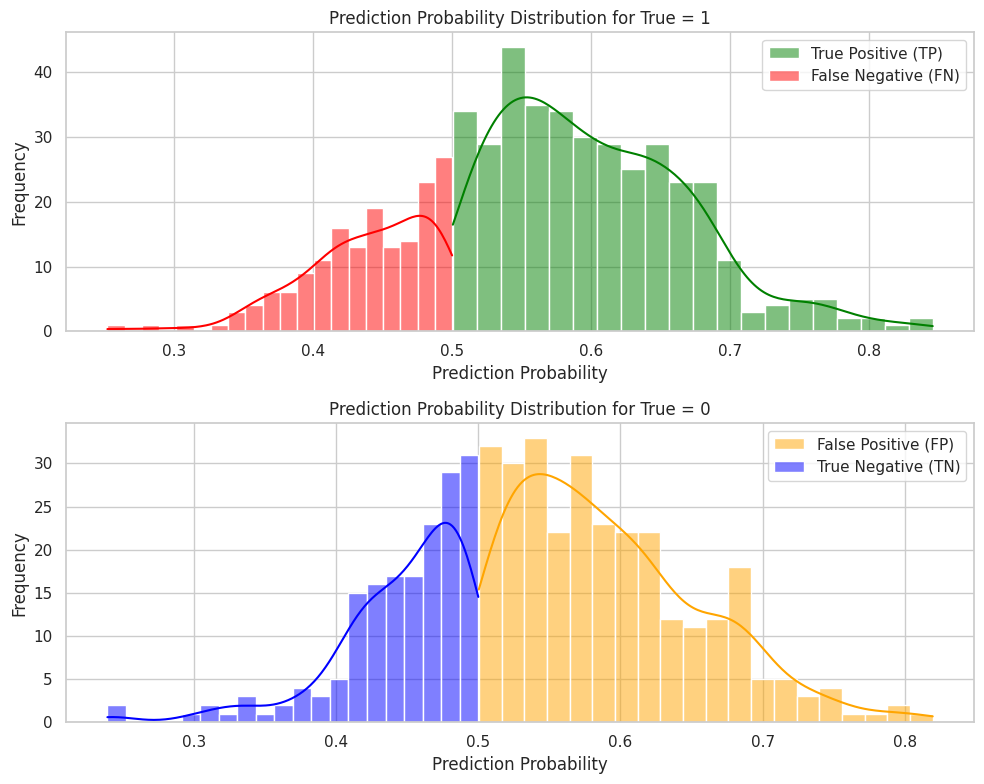

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the plot style
sns.set(style="whitegrid")

# Filter the data based on conditions
TP = results_df[(results_df['true_value'] == 1) & (results_df['predicted_value'] == 1)]
FN = results_df[(results_df['true_value'] == 1) & (results_df['predicted_value'] == 0)]
FP = results_df[(results_df['true_value'] == 0) & (results_df['predicted_value'] == 1)]
TN = results_df[(results_df['true_value'] == 0) & (results_df['predicted_value'] == 0)]

# Create the plots
fig, axes = plt.subplots(2, 1, figsize=(10, 8))

# Plot for True = 1
sns.histplot(TP['predicted_probability'], bins=20, kde=True, color='green', label='True Positive (TP)', ax=axes[0])
sns.histplot(FN['predicted_probability'], bins=20, kde=True, color='red', label='False Negative (FN)', ax=axes[0])
axes[0].set_title('Prediction Probability Distribution for True = 1')
axes[0].set_xlabel('Prediction Probability')
axes[0].set_ylabel('Frequency')
axes[0].legend()

# Plot for True = 0
sns.histplot(FP['predicted_probability'], bins=20, kde=True, color='orange', label='False Positive (FP)', ax=axes[1])
sns.histplot(TN['predicted_probability'], bins=20, kde=True, color='blue', label='True Negative (TN)', ax=axes[1])
axes[1].set_title('Prediction Probability Distribution for True = 0')
axes[1].set_xlabel('Prediction Probability')
axes[1].set_ylabel('Frequency')
axes[1].legend()

# Adjust layout for better readability
plt.tight_layout()

# Show the plot
plt.show()

In [58]:
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# Define a list of custom thresholds
thresholds = [0.4, 0.45, 0.5, 0.55, 0.6]

# Initialize an empty list to store the results
results_list = []

# Iterate over each threshold
for threshold in thresholds:
    # Apply the threshold to recalculate the predicted values
    custom_pred = np.where(results_df['predicted_probability'] >= threshold, 1, 0)
    
    # Add the custom predicted values to the DataFrame
    results_df['custom_predicted_value'] = custom_pred
    
    # Recalculate the metrics based on the custom predictions
    accuracy = accuracy_score(results_df['true_value'], results_df['custom_predicted_value'])
    precision = precision_score(results_df['true_value'], results_df['custom_predicted_value'])
    recall = recall_score(results_df['true_value'], results_df['custom_predicted_value'])
    f1 = f1_score(results_df['true_value'], results_df['custom_predicted_value'])
    
    # ROC-AUC requires predicted probabilities, so we use the predicted probability column
    roc_auc = roc_auc_score(results_df['true_value'], results_df['predicted_probability'])
    
    # Append the results for this threshold to the list
    results_list.append({
        'Threshold': threshold,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'ROC-AUC': roc_auc
    })

# Convert the results list into a DataFrame
metrics_df = pd.DataFrame(results_list)

# Display the resulting DataFrame
metrics_df

,Threshold,Accuracy,Precision,Recall,F1 Score,ROC-AUC
0,0.40,0.528,0.534884,0.940520,0.681941,0.545648
1,0.45,0.525,0.537815,0.832714,0.653538,0.545648
2,0.50,0.542,0.560606,0.687732,0.617696,0.545648
3,0.55,0.542,0.586580,0.503717,0.542000,0.545648
4,0.60,0.517,0.596491,0.315985,0.413123,0.545648


# Logistic (random split)

In [14]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data
split_proportions = [0.85]

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.85] | Time Elapsed: 0.419 seconds
Training - Accuracy: 0.633 | F1 Score: 0.752
Validation - Accuracy: 0.615 | F1 Score: 0.736


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.85,0.632878,0.75239,0.614914,0.736107,0.419141


# Logistic (split)

In [15]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
# split_proportions = list(range(0.05, 0.96, 0.5))
# split_proportions = np.arange(0.05, 0.96, 0.05)
split_proportions = [0.65]  # 85% training, 15% validation (change as needed)

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Calculate the index to split the data
    split_index = int(train_size * len(X))
    
    # Split the dataset into training and validation sets (using the first 70% for training)
    X_train = X[:split_index]
    y_train = y[:split_index]
    X_val = X[split_index:]
    y_val = y[split_index:]

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.65] | Time Elapsed: 0.305 seconds
Training - Accuracy: 0.666 | F1 Score: 0.786
Validation - Accuracy: 0.548 | F1 Score: 0.606


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.65,0.665663,0.785671,0.548393,0.606245,0.305231


# Logistic Predictions Evaluations

In [17]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Create 'next_close' and 'next_close_change'
X_new['next_close'] = X_new['close'].shift(-1)
X_new['next_close_change'] = X_new['next_close'] - X_new['close']

# Create binary labels for 'next_close_change' (1 if positive change, 0 if non-positive)
X_new['next_close_change_binary'] = (X_new['next_close_change'] > 0).astype(int)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change', 'next_close', 'next_close_change_binary'], axis=1)
y_new = X_new[['date', 'close', 'next_close', 'next_close_change', 'next_close_change_binary']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Use the pre-trained model to predict on the normalized new data
binary_predictions = model.predict(X_new_normalized)

# Create a DataFrame with the required format
results = y_new.copy()
results['binary_prediction'] = binary_predictions  # Add binary predictions

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change_binary'].values  # True binary labels based on next_close_change
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.4756
F1 Score: 0.3768


/home/ubuntu/.local/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


,date,close,next_close,next_close_change,next_close_change_binary,binary_prediction
0,2024-12-02 00:00:00,15821.0,15820.0,-1.0,0,1.0
1,2024-12-02 01:00:00,15820.0,15810.0,-10.0,0,1.0
2,2024-12-02 02:00:00,15810.0,15811.0,1.0,1,1.0
3,2024-12-02 03:00:00,15811.0,15806.0,-5.0,0,1.0
4,2024-12-02 04:00:00,15806.0,15731.0,-75.0,0,1.0
...,...,...,...,...,...,...
77,2024-12-05 05:00:00,15881.0,15871.0,-10.0,0,1.0
78,2024-12-05 06:00:00,15871.0,15887.0,16.0,1,1.0
79,2024-12-05 07:00:00,15887.0,15893.0,6.0,1,1.0
80,2024-12-05 08:00:00,15893.0,15909.0,16.0,1,1.0


In [20]:
# Save results to Excel
results.to_excel('predictions_results.xlsx', index=False)

# Display the resulting DataFrame
print("Results saved to 'predictions_results.xlsx'")

Results saved to 'predictions_results.xlsx'


In [114]:
# Extract model parameters
coefficients = model.coef_
intercept = model.intercept_

print(coefficients)
print(intercept)

[[-0.20833713 -0.21106198 -0.04181081  0.02010952  0.00817884  0.24352341
   0.03915552  0.03553821 -0.29321092  0.30563756 -0.05442775]]
[0.11425722]


In [158]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change'], axis=1)
y_new = X_new[['date', 'next_close_change']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Calculate the linear combination (logits)
logits = X_new_normalized @ coefficients.T + intercept

# Apply the sigmoid function to get probabilities
probabilities = 1 / (1 + np.exp(-logits))

# Convert probabilities to binary predictions (threshold = 0.5)
binary_predictions = (probabilities >= 0.5).astype(int)

# Create a DataFrame with the required format
results = y_new.copy()
results['probability'] = probabilities.to_numpy().tolist()
results['binary_prediction'] = binary_predictions.to_numpy().tolist()

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change'].values  # True labels from the dataset
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.5352
F1 Score: 0.4762


,date,next_close_change,probability,binary_prediction
0,2024-12-02 00:00:00,0.0,[0.5678258347793993],[1]
1,2024-12-02 01:00:00,0.0,[0.565656669012011],[1]
2,2024-12-02 02:00:00,1.0,[0.5588725679094291],[1]
3,2024-12-02 03:00:00,0.0,[0.5659484613149471],[1]
4,2024-12-02 04:00:00,0.0,[0.5629349037472455],[1]
...,...,...,...,...
66,2024-12-04 18:00:00,0.0,[0.4536095326443316],[0]
67,2024-12-04 19:00:00,1.0,[0.48282423623012033],[0]
68,2024-12-04 20:00:00,1.0,[0.4846877962007912],[0]
69,2024-12-04 21:00:00,0.0,[0.48825682330209463],[0]


In [159]:
results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   date               71 non-null     datetime64[ns]
 1   next_close_change  71 non-null     float64       
 2   probability        71 non-null     object        
 3   binary_prediction  71 non-null     object        
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 2.3+ KB


In [160]:
# Filter the DataFrame based on next_close_change == 1 and next_close_change == 0
next_close_change_1 = results[results['next_close_change'] == 1]
next_close_change_0 = results[results['next_close_change'] == 0]

pct_1 = len(next_close_change_1)/(len(next_close_change_1) + len(next_close_change_0))*100
pct_0 = len(next_close_change_0)/(len(next_close_change_1) + len(next_close_change_0))*100

# Calculate the max, min, and avg probability for each case
probabilities_1 = next_close_change_1['probability'].apply(lambda x: x[0])  # Extracting the probability value from the list
probabilities_0 = next_close_change_0['probability'].apply(lambda x: x[0])

# Get the desired statistics
stats_1 = {
    'max': probabilities_1.max(),
    'min': probabilities_1.min(),
    'avg': probabilities_1.mean(),
    'med': probabilities_1.median()
}

stats_0 = {
    'max': probabilities_0.max(),
    'min': probabilities_0.min(),
    'avg': probabilities_0.mean(),
    'med': probabilities_0.median()
}

# Display the results
print(f'1 is {pct_1:.2f}% of the data')
print(f'0 is {pct_0:.2f}% of the data')

print("\nWhen next_close_change == 1:")
print(f"Max probability: {stats_1['max']:.4f}")
print(f"Min probability: {stats_1['min']:.4f}")
print(f"Avg probability: {stats_1['avg']:.4f}")
print(f"Median probability: {stats_1['med']:.4f}")

print("\nWhen next_close_change == 0:")
print(f"Max probability: {stats_0['max']:.4f}")
print(f"Min probability: {stats_0['min']:.4f}")
print(f"Avg probability: {stats_0['avg']:.4f}")
print(f"Median probability: {stats_0['med']:.4f}")

1 is 49.30% of the data
0 is 50.70% of the data

When next_close_change == 1:
Max probability: 0.6503
Min probability: 0.3615
Avg probability: 0.4965
Median probability: 0.4954

When next_close_change == 0:
Max probability: 0.6014
Min probability: 0.3388
Avg probability: 0.4779
Median probability: 0.4910


In [152]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)


Accuracy: 0.5352112676056338
F1 Score: 0.47619047619047616


In [162]:
# Extract the probability values from the list
results['probability'] = results['probability'].apply(lambda x: x[0] if isinstance(x, list) else x)

# Modify the binary_prediction based on the condition
results['binary_prediction'] = (results['probability'] >= 0.55).astype(int)

# Convert 'next_close_change' to int
results['next_close_change'] = results['next_close_change'].astype(int)

# Convert 'probability' and 'binary_prediction' to object
results['probability'] = results['probability'].astype(object)
results['binary_prediction'] = results['binary_prediction'].astype(object)

# Display the updated DataFrame
print(results[['date', 'next_close_change', 'probability', 'binary_prediction']])

# If results is already a DataFrame and you just want to return or display it:
results_df = pd.DataFrame(results)  # If not already in DataFrame form

                  date  next_close_change probability binary_prediction
0  2024-12-02 00:00:00                  0    0.567826                 1
1  2024-12-02 01:00:00                  0    0.565657                 1
2  2024-12-02 02:00:00                  1    0.558873                 1
3  2024-12-02 03:00:00                  0    0.565948                 1
4  2024-12-02 04:00:00                  0    0.562935                 1
..                 ...                ...         ...               ...
66 2024-12-04 18:00:00                  0     0.45361                 0
67 2024-12-04 19:00:00                  1    0.482824                 0
68 2024-12-04 20:00:00                  1    0.484688                 0
69 2024-12-04 21:00:00                  0    0.488257                 0
70 2024-12-04 22:00:00                  0    0.486296                 0

[71 rows x 4 columns]


In [165]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5070422535211268
F1 Score: 0.2553191489361702


# Random Forests

In [17]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 500     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [1000]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = RandomForestClassifier(n_estimators=100, random_state=42)
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 15353


Processing window 500 of 15353
Processing window 1000 of 15353
Processing window 1500 of 15353
Processing window 2000 of 15353
Processing window 2500 of 15353
Processing window 3000 of 15353
Processing window 3500 of 15353
Processing window 4000 of 15353
Processing window 4500 of 15353
Processing window 5000 of 15353
Processing window 5500 of 15353
Processing window 6000 of 15353
Processing window 6500 of 15353
Processing window 7000 of 15353
Processing window 7500 of 15353
Processing window 8000 of 15353
Processing window 8500 of 15353
Processing window 9000 of 15353
Processing window 9500 of 15353
Processing window 10000 of 15353
Processing window 10500 of 15353
Processing window 11000 of 15353
Processing window 11500 of 15353
Processing window 12000 of 15353
Processing window 12500 of 15353
Processing window 13000 of 15353
Processing window 13500 of 15353
Processing window 14000 of 15353
Processing window 14500 of 15353
Processing window 15000 of 15353
Window size [1000] | Time Elap

,window_size,avg_train_accuracy,avg_train_f1,avg_train_roc_auc,validation_accuracy,validation_f1,validation_roc_auc
0,1000,0.999999,0.999999,1.0,0.602684,0.699862,0.556001


In [20]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = RandomForestClassifier(n_estimators=40, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.6] | Time Elapsed: 2.170 seconds
Training - Accuracy: 0.999 | F1 Score: 1.000
Validation - Accuracy: 0.620 | F1 Score: 0.715
Train Size [0.65] | Time Elapsed: 2.351 seconds
Training - Accuracy: 0.999 | F1 Score: 0.999
Validation - Accuracy: 0.618 | F1 Score: 0.714
Train Size [0.7] | Time Elapsed: 2.479 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.618 | F1 Score: 0.713
Train Size [0.75] | Time Elapsed: 2.736 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.619 | F1 Score: 0.714
Train Size [0.8] | Time Elapsed: 2.916 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.615 | F1 Score: 0.708
Train Size [0.85] | Time Elapsed: 3.154 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.610 | F1 Score: 0.705
Train Size [0.9] | Time Elapsed: 3.535 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.611 | F1 Score: 0.707
Train Size [0.95] | Time

,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.60,0.999490,0.999603,0.619994,0.714515,2.169527
1,0.65,0.999247,0.999413,0.618099,0.714323,2.350947
2,0.70,0.999563,0.999658,0.617893,0.712732,2.478928
3,0.75,0.999755,0.999808,0.618978,0.713813,2.736461
4,0.80,1.000000,1.000000,0.614797,0.708333,2.916268
5,0.85,0.999568,0.999662,0.609617,0.704503,3.154287
6,0.90,0.999592,0.999680,0.611247,0.706642,3.534564
7,0.95,0.999485,0.999595,0.618582,0.720430,3.700620


# GaussianNB

In [18]:
import time
import numpy as np
import pandas as pd
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 500     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [1000]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = GaussianNB()
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 15353
Processing window 500 of 15353
Processing window 1000 of 15353
Processing window 1500 of 15353
Processing window 2000 of 15353
Processing window 2500 of 15353
Processing window 3000 of 15353
Processing window 3500 of 15353
Processing window 4000 of 15353
Processing window 4500 of 15353
Processing window 5000 of 15353
Processing window 5500 of 15353
Processing window 6000 of 15353
Processing window 6500 of 15353
Processing window 7000 of 15353
Processing window 7500 of 15353
Processing window 8000 of 15353
Processing window 8500 of 15353
Processing window 9000 of 15353
Processing window 9500 of 15353
Processing window 10000 of 15353
Processing window 10500 of 15353
Processing window 11000 of 15353
Processing window 11500 of 15353
Processing window 12000 of 15353
Processing window 12500 of 15353
Processing window 13000 of 15353
Processing window 13500 of 15353
Processing window 14000 of 15353
Processing window 14500 of 15353
Processing window 15000 of 15353
W

,window_size,avg_train_accuracy,avg_train_f1,avg_train_roc_auc,validation_accuracy,validation_f1,validation_roc_auc
0,1000,0.601702,0.683721,0.613888,0.541327,0.585472,0.551376


# XGBoost

In [22]:
import time
import numpy as np
import pandas as pd
from xgboost import XGBClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 100      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = XGBClassifier(
            objective='binary:logistic',  # For binary classification
            n_estimators=100,  # Number of trees
            learning_rate=0.1,  # Learning rate
            max_depth=6,  # Maximum depth of each tree
            random_state=42,
            use_label_encoder=False)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 226


/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:16:24] WARNING: /workspace/sr

Window size [600] | Time Elapsed: 7709.709 seconds
Average F1 Score: 0.274 | Average Accuracy: 0.513 %


,window_size,avg_f1_score,avg_accuracy,total_time
0,600,0.274336,0.513274,7709.70916


# LightGBM

In [19]:
import time
import numpy as np
import pandas as pd
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_h_features_filtered.drop(['date', 'close_movement'], axis=1)
target_df = df_h_features_filtered['close_movement']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 500     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [1000]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LGBMClassifier(
            n_estimators=100,
            learning_rate=0.1,
            max_depth=50,  # No limit by default, can be adjusted
            random_state=42)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 15353
[LightGBM] [Info] Number of positive: 710, number of negative: 290
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4931
[LightGBM] [Info] Number of data points in the train set: 1000, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.710000 -> initscore=0.895384
[LightGBM] [Info] Start training from score 0.895384
[LightGBM] [Info] Number of positive: 710, number of negative: 290
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000730 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4928
[LightGBM] [Info] Number of data points in the train set: 1000, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.710000 -> inits

,window_size,avg_train_accuracy,avg_train_f1,avg_train_roc_auc,validation_accuracy,validation_f1,validation_roc_auc
0,1000,0.998515,0.998792,0.999987,0.606136,0.700154,0.562593


In [ ]:
import time
import numpy as np
import pandas as pd
from lightgbm import LGBMClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LGBMClassifier(
            n_estimators=100,
            learning_rate=0.1,
            max_depth=-1,  # No limit by default, can be adjusted
            random_state=42)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3110
[LightGBM] [Info] Number of positive: 359, number of negative: 241
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1690
[LightGBM] [Info] Number of data points in the train set: 600, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.598333 -> initscore=0.398525
[LightGBM] [Info] Start training from score 0.398525
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

# SVM

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.svm import SVC

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

# NN

# Linear Regression

In [96]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(1100, 1601, 20))
window_sizes = [1220] 

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store RMSEs and percentages
    all_val_rmse = []
    all_val_rmse_perc = []
    all_train_rmse = []
    all_train_rmse_perc = []
    total_window_times = 0  # Variable to store total time for all windows
    all_val_change = []
    all_pred_change = []

    # Counters and variables for prediction comparison to actual values
    lower_count = 0
    higher_count = 0
    max_rmse_perc_lower = 0  # To store max RMSE% when prediction is lower than actual
    max_rmse_perc_higher = 0  # To store max RMSE% when prediction is higher than actual

    # Separate lists to store RMSE percentage for lower and higher predictions
    lower_rmse_percs = []
    higher_rmse_percs = []

    # Separate lists to store val_rmse for lower and higher predictions
    rmse_lower_perc = []  # To store RMSE when prediction is lower than actual
    rmse_higher_perc = []  # To store RMSE when prediction is higher than actual

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Get the column index for 'next_close' from features_df
        close_index = features_df.columns.get_loc('hourly_close_last')

        # Normalize y_train using the mean and std of weekly_volatility
        close_mean = X_train[:, close_index].mean()
        close_std = X_train[:, close_index].std()
        y_train_normalized = (y_train - close_mean) / close_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        # Predict on training data
        y_pred_train = model.predict(X_train_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_train_denorm = y_train * close_std + close_mean
        y_pred_train_denorm = y_pred_train * close_std + close_mean
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Calculate RMSE and RMSE percentage for validation
        mse_val = np.mean((y_val - y_pred_val_denorm) ** 2)
        rmse_val = np.sqrt(mse_val)
        rmse_val_perc = (rmse_val / y_val)[0] * 100  # Convert to percentage

        val_change = y_val - X_val[0][close_index]
        pred_change = y_pred_val_denorm - X_val[0][close_index]
        
        # Calculate RMSE for training
        mse_train = np.mean((y_train - y_pred_train_denorm) ** 2)
        rmse_train = np.sqrt(mse_train)
        rmse_train_perc = ((y_train - y_pred_train_denorm) ** 2 / y_train).mean() * 100  # Convert to percentage

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Append RMSEs and percentage errors
        all_val_rmse.append(rmse_val)
        all_val_rmse_perc.append(rmse_val_perc)
        all_train_rmse.append(rmse_train)
        all_train_rmse_perc.append(rmse_train_perc)
        all_val_change.append(val_change)
        all_pred_change.append(pred_change)

        # Count predictions relative to actual values and update max RMSE percentage
        if y_pred_val_denorm < y_val:
            lower_count += 1
            lower_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for lower predictions
            max_rmse_perc_lower = max(max_rmse_perc_lower, rmse_val_perc)
        elif y_pred_val_denorm > y_val:
            higher_count += 1
            higher_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for higher predictions
            max_rmse_perc_higher = max(max_rmse_perc_higher, rmse_val_perc)


        # Move to the next window based on the gap
        window_number += gap

    # Initialize counters
    match_count = 0
    not_match_count = 0

    # Iterate over both lists simultaneously
    for val_change, pred_change in zip(all_val_change, all_pred_change):
        if val_change >= 0 and pred_change >= 0:
            match_count += 1
        elif val_change < 0 and pred_change < 0:
            match_count += 1
        else:
            not_match_count += 1

    # Calculate percentage for lower and higher counts
    lower_count_perc = (lower_count / num_windows) * 100
    higher_count_perc = (higher_count / num_windows) * 100

    # Calculate average RMSE percentage errors for lower and higher predictions
    avg_rmse_perc_lower = np.mean(lower_rmse_percs) if lower_rmse_percs else 0
    avg_rmse_perc_higher = np.mean(higher_rmse_percs) if higher_rmse_percs else 0

    # Calculate average, max, min, and variance for validation and training RMSEs, percentages
    avg_val_rmse = np.mean(all_val_rmse)
    var_val_rmse = np.var(all_val_rmse)

    avg_val_rmse_perc = np.mean(all_val_rmse_perc)
    var_val_rmse_perc = np.var(all_val_rmse_perc)
    max_avg_val_rmse_perc = np.max(all_val_rmse_perc)

    avg_train_rmse = np.mean(all_train_rmse)
    var_train_rmse = np.var(all_train_rmse)

    avg_train_rmse_perc = np.mean(all_train_rmse_perc)
    var_train_rmse_perc = np.var(all_train_rmse_perc)

    # Calculate percentage of times RMSE is less than or equal to 60
    rmse_less_equal_60_perc = (np.sum(np.array(all_val_rmse) <= 60) / len(all_val_rmse)) * 100

    # Calculate percentage of times prediction is lower or equal to average RMSE
    percentage_lower_equal_avg_rmse = (np.sum(np.array(all_val_rmse) <= avg_val_rmse) / len(all_val_rmse)) * 100

    match_pct = match_count / (match_count + not_match_count) * 100
    not_match_pct = not_match_count / (match_count + not_match_count) * 100

    # Append results to the list with updated metric name
    results.append({
        'window_size': window_size,
        'avg_val_rmse': avg_val_rmse,
        'windowed_confidence_level': percentage_lower_equal_avg_rmse,  # Renamed metric
        'var_val_rmse': var_val_rmse,
        'avg_val_rmse_perc': avg_val_rmse_perc,
        'var_val_rmse_perc': var_val_rmse_perc,
        'avg_train_rmse': avg_train_rmse,
        'var_train_rmse': var_train_rmse,
        'avg_train_rmse_perc': avg_train_rmse_perc,
        'var_train_rmse_perc': var_train_rmse_perc,
        'window_time': total_window_times,
        'max_avg_val_rmse_perc': max_avg_val_rmse_perc,
        'lower_count_perc': lower_count_perc,
        'higher_count_perc': higher_count_perc,
        'max_rmse_perc_lower': max_rmse_perc_lower,
        'max_rmse_perc_higher': max_rmse_perc_higher,
        'avg_rmse_perc_lower': avg_rmse_perc_lower,
        'avg_rmse_perc_higher': avg_rmse_perc_higher,
        'rmse_less_equal_60_perc': rmse_less_equal_60_perc,
        'match_pct': match_pct,
        'not_match_pct': not_match_pct,
    })

    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Prediction Error: {avg_val_rmse:.3f} IDR | {avg_val_rmse_perc:.3f} % | Confidence Level: {percentage_lower_equal_avg_rmse:.3f} % ')
    print(f'Under Predict - Count: {lower_count_perc:.3f} % | Average: {avg_rmse_perc_lower:.3f} % | Max: {max_rmse_perc_lower:.3f} %')
    print(f'Over Predict - Count: {higher_count_perc:.3f} % | Average: {avg_rmse_perc_higher:.3f} % | Max: {max_rmse_perc_higher:.3f} %')
    print(f'Average Prediction Error that less than 60 IDR: {rmse_less_equal_60_perc:.3f} %')
    print(f'Match Percentage: {match_pct:.3f} % | Not Match Percentage: {not_match_pct:.3f} %')
    print(f'===========================================================================')

# Optionally, you could convert the results to a DataFrame or CSV for further analysis
results_summary = pd.DataFrame(results)
results_summary

Processing window 0 of 1067
Processing window 500 of 1067
Processing window 1000 of 1067
Window size [1220] | Time Elapsed: 3.586 seconds
Average Prediction Error: 38.573 IDR | 0.250 % | Confidence Level: 64.667 % 
Under Predict - Count: 57.919 % | Average: 0.253 % | Max: 1.900 %
Over Predict - Count: 42.081 % | Average: 0.246 % | Max: 1.726 %
Average Prediction Error that less than 60 IDR: 79.194 %
Match Percentage: 51.359 % | Not Match Percentage: 48.641 %


,window_size,avg_val_rmse,windowed_confidence_level,var_val_rmse,avg_val_rmse_perc,var_val_rmse_perc,avg_train_rmse,var_train_rmse,avg_train_rmse_perc,var_train_rmse_perc,...,max_avg_val_rmse_perc,lower_count_perc,higher_count_perc,max_rmse_perc_lower,max_rmse_perc_higher,avg_rmse_perc_lower,avg_rmse_perc_higher,rmse_less_equal_60_perc,match_pct,not_match_pct
0,1220,38.573242,64.667291,1499.977544,0.249814,0.061159,88.127713,357.327303,54.509003,480.469591,...,1.899925,57.9194,42.0806,1.899925,1.725529,0.252691,0.245854,79.194002,51.35895,48.64105


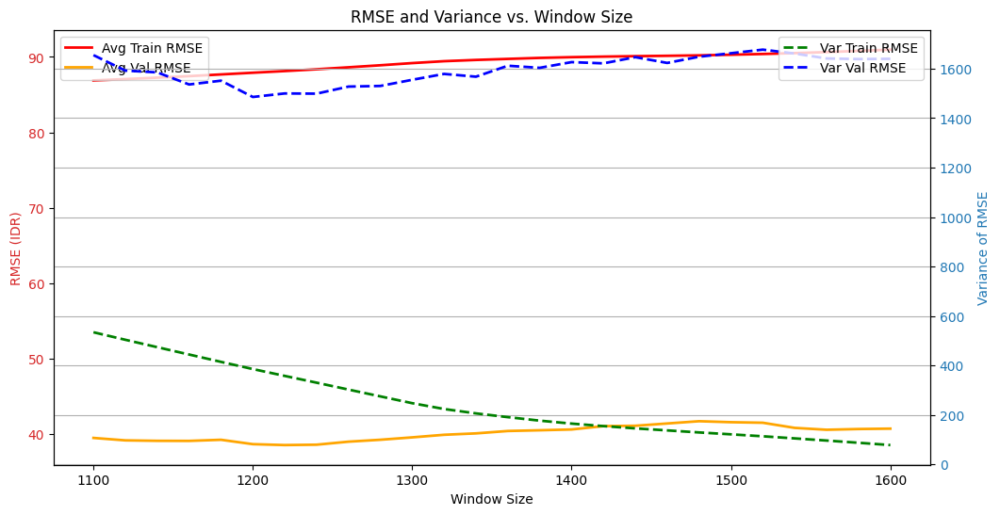

In [57]:
import matplotlib.pyplot as plt

# Ensure you have results_summary populated before running this code
if not results_summary.empty:
    # Plotting RMSE and Variance
    fig, ax1 = plt.subplots(figsize=(12, 6))

    # RMSE Plot
    color = 'tab:red'
    ax1.set_xlabel('Window Size')
    ax1.set_ylabel('RMSE (IDR)', color=color)

    # Plot average RMSE as lines without points
    ax1.plot(results_summary['window_size'].values, results_summary['avg_train_rmse'].values, 
              label='Avg Train RMSE', color='red', linewidth=2)
    ax1.plot(results_summary['window_size'].values, results_summary['avg_val_rmse'].values, 
              label='Avg Val RMSE', color='orange', linewidth=2)

    ax1.tick_params(axis='y', labelcolor=color)
    ax1.legend(loc='upper left')

    # Create a second y-axis for variance
    ax2 = ax1.twinx()
    color = 'tab:blue'
    ax2.set_ylabel('Variance of RMSE', color=color)  # Set the label for the second Y axis

    # Plot variance of RMSE as lines without points
    ax2.plot(results_summary['window_size'].values, results_summary['var_train_rmse'].values, 
             label='Var Train RMSE', color='green', linestyle='--', linewidth=2)
    ax2.plot(results_summary['window_size'].values, results_summary['var_val_rmse'].values, 
             label='Var Val RMSE', color='blue', linestyle='--', linewidth=2)

    ax2.tick_params(axis='y', labelcolor=color)
    ax2.legend(loc='upper right')

    plt.title('RMSE and Variance vs. Window Size')
    plt.grid()
    plt.show()
else:
    print("Results summary is empty.")

In [62]:
from sklearn.linear_model import LinearRegression
import numpy as np
import pandas as pd

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']
date_df = df_features['date']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
window_size = 1220  # Optimal window size based on parameter tuning
num_display = 20    # Number of recent predictions to display

# Lists to store validation and training RMSEs (excluding the last window from avg calculations)
all_val_rmse = []
all_val_rmse_perc = []
all_train_rmse = []
all_train_rmse_perc = []

# Store predictions only for the latest date on the data
last_predictions = []

# Number of windows to process
num_windows = len(X) - window_size - 1  # Exclude last row for training

# Loop through each sliding window
window_number = 0
while window_number <= num_windows:
    start = window_number
    end = start + window_size
    X_train = X[start:end]
    y_train = y[start:end]

    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Get the column index for 'next_close' from features_df
    close_index = features_df.columns.get_loc('hourly_close_last')

    # Normalize y_train using the mean and std of weekly_volatility
    close_mean = X_train[:, close_index].mean()
    close_std = X_train[:, close_index].std()
    y_train_normalized = (y_train - close_mean) / close_std
    
    # Prepare validation data for prediction
    if end < len(X) - 1:  # Ensure there's data for validation
        X_val = X[end:end + 1]  # Validation is the next row after the current window
        y_val = y[end:end + 1]  # The target for validation
        val_date = date_df.iloc[end:end + 1].values  # Get the date for validation

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Skip this iteration if y_train contains NaN
        if np.isnan(y_train).any() or np.isnan(y_val).any():
            window_number += 1
            continue

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Check if we're in the last 3 windows to display
        if end >= len(X) - num_display:
            # Use the date for the next row as the prediction date
            if end + 1 < len(X):  # Ensure there's a valid next row
                next_row_date = date_df.iloc[end + 1]
                last_predictions.append((next_row_date, y_val[0], y_pred_val_denorm[0]))

    # Move to the next window
    window_number += 1

# Use the features of the last row for prediction
if len(X) > 0:
    last_row_features = X[-1].reshape(1, -1)  # Reshape to 2D for prediction
    last_row_pred = model.predict(last_row_features)
    last_row_date = date_df.iloc[-1]

    # Append the last row prediction with the correct date
    last_predictions.append((last_row_date + pd.Timedelta(hours=1), np.nan, last_row_pred[0]))

# Print the most recent predictions and actual values for the last three days
print("\nRecent Predictions and Actual Values:")
for i, (date, actual, pred) in enumerate(reversed(last_predictions)):
    if np.isnan(actual):
        print(f"Date: {date}, Prediction: {pred:.3f}")
    else:
        error = abs(actual - pred)  # Calculate the absolute error
        error_perc = ((pred/actual)-1)*100
        print(f"Date: {date}, Prediction: {pred:.3f}, Actual: {actual:.3f},  Error: {error:.3f}, Error %: {error_perc:.3f}%")


Recent Predictions and Actual Values:
Date: 2024-12-06, Prediction: 15762.924
Date: 2024-12-06, Prediction: 15912.094, Actual: 15957.000,  Error: 44.906, Error %: -0.281%
Date: 2024-12-05, Prediction: 16023.673, Actual: 15917.000,  Error: 106.673, Error %: 0.670%
Date: 2024-12-04, Prediction: 15925.162, Actual: 16034.000,  Error: 108.838, Error %: -0.679%
Date: 2024-12-03, Prediction: 15887.720, Actual: 15928.000,  Error: 40.280, Error %: -0.253%
Date: 2024-12-02, Prediction: 15871.864, Actual: 15900.000,  Error: 28.136, Error %: -0.177%
Date: 2024-12-01, Prediction: 15859.354, Actual: 15871.000,  Error: 11.646, Error %: -0.073%
Date: 2024-11-30, Prediction: 15840.941, Actual: 15854.000,  Error: 13.059, Error %: -0.082%
Date: 2024-11-29, Prediction: 15899.439, Actual: 15859.000,  Error: 40.439, Error %: 0.255%
Date: 2024-11-28, Prediction: 15984.822, Actual: 15900.000,  Error: 84.822, Error %: 0.533%
Date: 2024-11-27, Prediction: 15999.546, Actual: 15986.000,  Error: 13.546, Error %: 